In [1]:
%load_ext autoreload
%autoreload 1
%matplotlib inline

In [2]:
import os, sys
from os.path import join as pjoin
sys.path.insert(0, pjoin(os.path.pardir, 'webapi'))
sys.path.insert(0, pjoin(os.path.pardir, os.path.pardir, 'mcdose'))
import numpy as np
import h5py
from bson import ObjectId
from matplotlib.colors import Normalize
import matplotlib.pyplot as plt

os.environ['CUDA_VISIBLE_DEVICES'] = ""
%aimport loaders
%aimport mcdose
from mcdose.visualize import vis_slice
import database
from api_enums import DBCOLLECTIONS

# Sparse Matrix Test

In [3]:
import h5py
from scipy import sparse
def get_dense_dose(f):
    with h5py.File(f, 'r') as fd:
        data = fd['data'][()]
        sparsevol = sparse.coo_matrix((data, (fd['i'][()], fd['j'][()])), shape=(fd['nrows'][()], fd['ncols'][()]))
        densevol = np.reshape(sparsevol.sum(axis=1).A, (111,113,192))
        print('sparse data size (GB): ', sparsevol.data.nbytes/1024.0/1024.0/1024.0)
        print('dense data size (GB):  ', densevol.nbytes/1024.0/1024.0/1024.0)
    return sparsevol, densevol

In [4]:
f = '/media/hdd1/g4sim/beamlet_dose/HN011/1.5T/2000/beamlet_dose_noisy_ctx16_tNone.h5'
spvol_noisy_2k, dvol_noisy_2k = get_dense_dose(f)
f = '/media/hdd1/g4sim/beamlet_dose/HN011/1.5T/2000/beamlet_dose_predicted_ctx16_tNone.h5'
spvol_pred_2k, dvol_pred_2k = get_dense_dose(f)
f = '/media/hdd1/g4sim/beamlet_dose/HN011/1.5T/1e5/beamlet_dose_true_ctx16_tNone.h5'
spvol_true_2k, dvol_true_2k = get_dense_dose(f)

sparse data size (GB):  0.14411091059446335
dense data size (GB):   0.008971452713012695
sparse data size (GB):  0.7944158278405666
dense data size (GB):   0.008971452713012695
sparse data size (GB):  0.6370134577155113
dense data size (GB):   0.008971452713012695


In [6]:
dens_noisy_2k = spvol_noisy_2k.toarray()
dens_pred_2k = spvol_pred_2k.toarray()
dens_true_2k = spvol_true_2k.toarray()

In [7]:
del spvol_noisy_2k, spvol_pred_2k, spvol_true_2k


In [18]:
randidx = sorted(np.random.choice(dens_noisy_2k.shape[1], size=(300,), replace=False))

[3, 13, 22, 44, 57, 62, 64, 80, 81, 85, 94, 98, 106, 117, 124, 140, 143, 147, 156, 160, 161, 169, 173, 177, 203, 210, 213, 229, 234, 243, 251, 265, 269, 272, 286, 287, 292, 296, 300, 308, 309, 314, 335, 342, 354, 357, 362, 366, 373, 374, 397, 404, 416, 418, 424, 433, 434, 441, 445, 453, 463, 473, 497, 501, 502, 510, 522, 526, 547, 569, 571, 578, 582, 597, 609, 612, 622, 632, 637, 639, 640, 648, 649, 651, 652, 661, 664, 667, 672, 681, 690, 696, 716, 725, 736, 737, 741, 763, 769, 770, 780, 799, 811, 815, 820, 825, 843, 846, 853, 856, 859, 867, 869, 870, 875, 888, 912, 919, 920, 923, 934, 938, 945, 946, 955, 959, 962, 967, 980, 990, 994, 1000, 1006, 1015, 1017, 1026, 1028, 1035, 1036, 1037, 1042, 1067, 1072, 1078, 1079, 1090, 1092, 1106, 1109, 1133, 1134, 1137, 1142, 1147, 1149, 1159, 1175, 1177, 1178, 1179, 1183, 1200, 1205, 1221, 1224, 1234, 1236, 1237, 1240, 1249, 1251, 1260, 1261, 1262, 1267, 1268, 1274, 1286, 1298, 1302, 1306, 1309, 1339, 1340, 1358, 1362, 1367, 1374, 1392, 1393, 139

In [ ]:
#sub_true_2k  = dens_true_2k[:, randidx]
#norm = np.amax(sub_true_2k, axis=0)
#sub_true_2k /= norm
#sub_noisy_2k = dens_noisy_2k[:, randidx] / norm
#sub_pred_2k = dens_pred_2k[:, randidx] / norm

#nnz_true = (sub_true_2k[sub_true_2k>1e-4]).size
print('NMAE Noisy: {:0.4e}'.format(np.mean(np.abs(sub_noisy_2k-sub_true_2k))))
print('NMAE Pred:  {:0.4e}'.format(np.mean(np.abs(sub_pred_2k-sub_true_2k))))
#print('nnz: {} of {}'.format(nnz_true, sub_true_2k.size))

NMAE Noisy: 1.0136e-04


In [20]:
print(np.mean(np.abs(dens_pred_2k[:, randidx]-dens_true_2k[:, randidx])/np.amax(dens_true_2k[:,randidx], axis=0)))

5.686573e-05


In [24]:
print(a[a>1e-5].size)
b = dens_pred_2k[:, randidx]
print(b[b>1e-5].size)

5588112
30296704


In [64]:
%aimport mcdose.visualize
from mcdose.visualize import create_volume_dose_figure
def show_dose(true, pred, noisy):
    fig = create_volume_dose_figure(
        np.stack([
            np.stack([
                true[slicenum],
                noisy[slicenum],
                pred[slicenum],
                noisy[slicenum]-true[slicenum],
                pred[slicenum]-true[slicenum],
                pred[slicenum]-true[slicenum],
            ]) for slicenum in range(22, true.shape[0]-26) ], axis=0),
        dpi=150, col_labels=["True", "Noisy", "Pred", 'Noisy-True', "Pred-True", "Pred-True"], return_fig=True,
    )
    return fig
fig = show_dose(dvol_true_2k, dvol_pred_2k, dvol_noisy_2k)

In [65]:
fig.savefig('new_allrot.png')

In [61]:

f = '/media/hdd1/g4sim/beamlet_dose/HN011/1.5T/2000/2020feb28/beamlet_dose_noisy_ctx16_tNone.h5'
_, dvol_noisy_2k = get_dense_dose(f)
f = '/media/hdd1/g4sim/beamlet_dose/HN011/1.5T/2000/2020feb28/beamlet_dose_predicted_ctx16_tNone.h5'
_, dvol_pred_2k = get_dense_dose(f)
f = '/media/hdd1/g4sim/beamlet_dose/HN011/1.5T/1e5/2020feb28/beamlet_dose_true_ctx16_tNone.h5'
_, dvol_true_2k = get_dense_dose(f)

sparse data size (GB):  0.029823079705238342
dense data size (GB):   0.008971452713012695
sparse data size (GB):  0.8904553651809692
dense data size (GB):   0.008971452713012695
sparse data size (GB):  0.7578196749091148
dense data size (GB):   0.008971452713012695


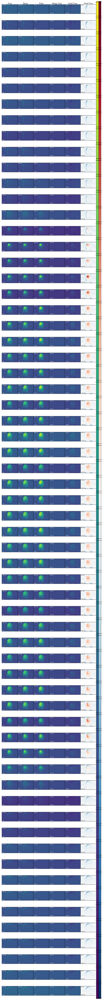

In [62]:
%aimport mcdose.visualize
from mcdose.visualize import create_volume_dose_figure
def show_dose(true, pred, noisy):
    fig = create_volume_dose_figure(
        np.stack([
            np.stack([
                true[slicenum],
                noisy[slicenum],
                pred[slicenum],
                noisy[slicenum]-true[slicenum],
                pred[slicenum]-true[slicenum],
                pred[slicenum]-true[slicenum],
            ]) for slicenum in range(22, true.shape[0]-26) ], axis=0),
        dpi=150, col_labels=["True", "Noisy", "Pred", 'Noisy-True', "Pred-True", "Pred-True"], return_fig=True,
    )
    return fig
fig = show_dose(dvol_true_2k, dvol_pred_2k, dvol_noisy_2k)
fig.savefig('old_predrotate.png')

# Load Optimized Dose

In [1]:
%aimport planio
from planio import OptimizedPlan

plans = OptimizedPlan.load_plans_from_file('/media/hdd1/g4sim/planning/DoseInfo.mat')
print(plans.keys())

UsageError: Line magic function `%aimport` not found.


/home/ryan/projects/MCDoseDenoiser/dosecalc/venv/lib/python3.6/site-packages/ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


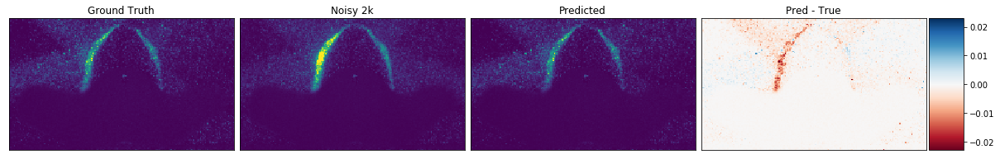

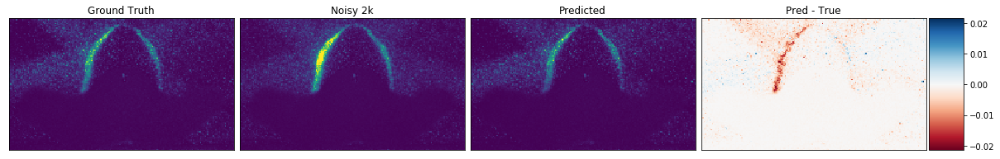

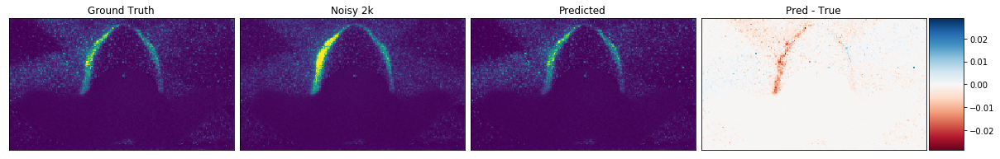

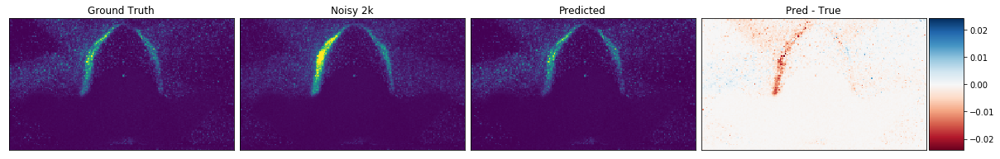

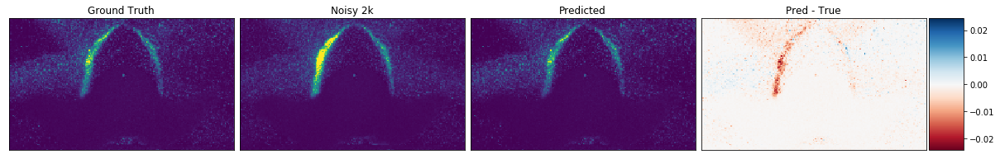

...

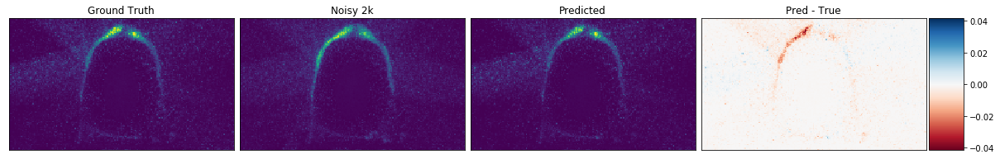

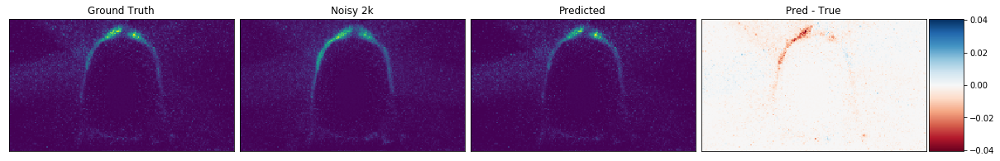

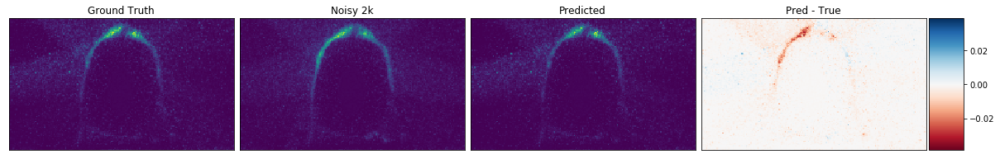

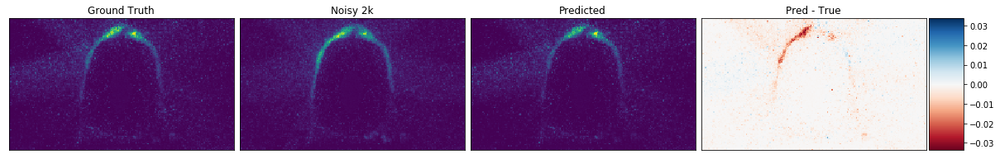

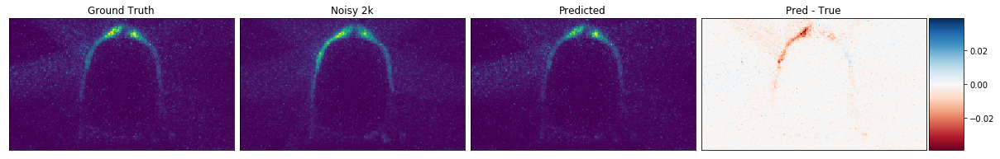

In [21]:
from matplotlib.gridspec import GridSpec
os.makedirs('figs_opt', exist_ok=True)
sf= 5
figsize = (sf*4.15, sf*113/192)

gtrue = plans['HN011 1.5T_1e5 Info10 eta1000'].gtdose
dmax = np.amax(gtrue)

true = gtrue / dmax
pred = plans['HN011 1.5T_2000_predicted Info10 eta1000'].gtdose / dmax
noise = plans['HN011 1.5T_2000 Info10 eta1000'].gtdose/ dmax

plt.close('all')
for ii in range(len(pred)):
    vmin = np.amin(pred[ii])
    vmax = np.amax(pred[ii])
    
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows=1, ncols=5, wspace=0,hspace=0,width_ratios=[1,1,1,1,0.15], figure=fig) 
    ax1 = fig.add_subplot(gs[0,0])
    ax1.imshow(true[ii], vmin=vmin, vmax=vmax)
    ax1.set_title('Ground Truth')
    ax2 = fig.add_subplot(gs[0,1])
    ax2.imshow(noise[ii], vmin=vmin, vmax=vmax)
    ax2.set_title('Noisy 2k')
    ax3 = fig.add_subplot(gs[0,2])
    im = ax3.imshow(pred[ii], vmin=vmin, vmax=vmax)
    ax3.set_title('Predicted')
    ax4 = fig.add_subplot(gs[0,3])
    diffabsmax = np.amax(np.abs(pred[ii]-true[ii]))
    im = ax4.imshow(pred[ii]-true[ii], cmap='RdBu', vmin=-diffabsmax, vmax=diffabsmax)
    ax4.set_title('Pred - True')
    for ax in fig.axes:
        ax.set_xticks([])
        ax.set_yticks([])
    ax4 = fig.add_subplot(gs[0,4])
    plt.colorbar(im, cax=ax4)
    fig.savefig('figs_opt/fig_{}'.format(ii))